# Лабараторная работа 2

Задание: векторизировать и кластеризировать данные

**Примечание:**  Из-за большого количества данных, выделяемая память для работы очень большая и пришлось так же локально сохранять дамп методов `segment` и `tag_morph` и после использования удалять неиспользуемые объекты.

In [2]:
import sqlite3
import nltk
from natasha import Segmenter, MorphVocab, NewsEmbedding, NewsMorphTagger, Doc
from pymorphy2 import MorphAnalyzer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle, shutil, os, re
from math import ceil

# Загружаем стоп-слова
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = set(stopwords.words('russian'))
stop_symb = set(['.', ' '])

# Инициализация инструментов для нормализации текста
segmenter = Segmenter()
morph_vocab = MorphVocab()
morph_analyzer = MorphAnalyzer()
emb = NewsEmbedding()
morph_tagger = NewsMorphTagger(emb)

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/kiwi_kam/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
# подключается
conn = sqlite3.connect('../Lab_1/test.db')
cur = conn.cursor()

db = cur.execute('''select body from test''').fetchall()


# достаем из кортежа и предваритльно фильтруем
texts = []
texts_cluster = []

for x in db:
    texts.append(re.sub('[\\n|/|||^A-Za-z|\\xa0]', ' ', x[0]))
    texts_cluster.append(re.sub('[\\n|/|||\\xa0]', ' ', x[0]))

/tmp/ipykernel_4317/2542823595.py:13: FutureWarning: Possible set union at position 5
  texts.append(re.sub('[\\n|/|||^A-Za-z|\\xa0]', ' ', x[0]))
/tmp/ipykernel_4317/2542823595.py:13: FutureWarning: Possible set union at position 6
  texts.append(re.sub('[\\n|/|||^A-Za-z|\\xa0]', ' ', x[0]))
/tmp/ipykernel_4317/2542823595.py:14: FutureWarning: Possible set union at position 5
  texts_cluster.append(re.sub('[\\n|/|||\\xa0]', ' ', x[0]))
/tmp/ipykernel_4317/2542823595.py:14: FutureWarning: Possible set union at position 6
  texts_cluster.append(re.sub('[\\n|/|||\\xa0]', ' ', x[0]))


Подготовка для обработки данных

In [ ]:
def temp_parse(text):
    temp = []
    for item in text:
        doc_temp = Doc(str(item))

        doc_temp.segment(segmenter)
        doc_temp.tag_morph(morph_tagger)
        temp.append(doc_temp)

    #print(len(temp))

    lst_doc = [x for x in range(0, len(temp), int(len(temp)*.02))]
    #print(len(lst_doc))

    part = ceil(len(temp)/len(lst_doc))
    num = [temp[part*k:part*(k+1)] for k in range(len(lst_doc))]

    temp = []

    shutil.rmtree('Dumps', ignore_errors=True)
    os.makedirs("Dumps", exist_ok=True)
    path = os.listdir('Dumps')
    list_file = []

    f_num = 0

    file_name = f'{str(f_num)}_doc_dump'


    for i in num:

        for j in i:
            temp.append(j)

        for item in path:
            if item == file_name:
                list_file.append(item)
                f_num = int(f_num)+1
                file_name = f'{str(f_num)}_doc_dump'

        with open(f'Dumps/{file_name}', 'ab') as file:
            pickle.dump(temp, file)
        path = os.listdir('Dumps')
        temp = []

temp_parse(texts)

### 1. Нормальизация

Используется 15 из 51 частей файла дампов, так как далее идут технические ограничения

In [46]:
# загружаем дамп и обрабатываем
def normalize_text(docs):

    doc = []
    for token in docs.tokens:
        token.lemmatize(morph_vocab)
        if token.lemma not in stop_words and token.lemma not in stop_symb:
            doc.append(token.lemma)

    return ' '.join(doc)

path = os.listdir('Dumps')
temp = []

# ограничение до 15 частей
for item in path[:15]:
    with open(f'Dumps/{item}', 'rb') as file:
        dump_doc = pickle.load(file)
        for item in dump_doc:
            temp.append(item)

normalized_texts = [normalize_text(item) for item in temp]

normalized_texts[:5]

['считать , дело никакой криминал источник : министерство здравоохранение красноярский край , артем ленц 24 защитник бывший замминистра минздрав красноярский край анна москвин эдуард клейман поделиться мнение задержание бывший чиновница обвинять превышение должностной полномочие поставка медоборудование следствие полагать , москвин закупить некачественный техника женщина отправить домашний арест адвокат рассказать 24 , дело вестись полтора-два год , , несмотря , москвин выдвинуть мера пресечение , считать , положение дело подзащитный ухудшаться дело возбудить фигурант , решить возбудить отношение разбираться дело давно идти , какой-то истерика следствие , разбираться эдуард клейман полагать , дело закупка замешать « сотрудник минздрав край » также адвокат полагать , допустить нарушение , оно состав преступление ряд действие , совершить сотрудник министерство , событие почему-то следствие решить , событие иметь какой-то криминальный характер свой позиция полтора год объяснять : « извини

После нормализации, убираем оставшиеся знаки препинания

In [47]:
for k, v in enumerate(normalized_texts):
    normalized_texts[k] = re.sub('[^А-Яа-я ]', '', v)

del temp, item, dump_doc, v

normalized_texts[:5]

['считать  дело никакой криминал источник  министерство здравоохранение красноярский край  артем ленц  защитник бывший замминистра минздрав красноярский край анна москвин эдуард клейман поделиться мнение задержание бывший чиновница обвинять превышение должностной полномочие поставка медоборудование следствие полагать  москвин закупить некачественный техника женщина отправить домашний арест адвокат рассказать   дело вестись полторадва год   несмотря  москвин выдвинуть мера пресечение  считать  положение дело подзащитный ухудшаться дело возбудить фигурант  решить возбудить отношение разбираться дело давно идти  какойто истерика следствие  разбираться эдуард клейман полагать  дело закупка замешать  сотрудник минздрав край  также адвокат полагать  допустить нарушение  оно состав преступление ряд действие  совершить сотрудник министерство  событие почемуто следствие решить  событие иметь какойто криминальный характер свой позиция полтора год объяснять   извинить  ребята  весь действие  кото

Вывод только для первых пяти нормализованных статей, для контроля того, что статьи были обработаны правильно

### 2. Векторизация

In [48]:
# Векторизация текста
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(normalized_texts).toarray()

del normalized_texts

X

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [49]:
print(f'Размер массива: {(X.nbytes)/1024**3} Гб')

Размер массива: 1.0137717425823212 Гб


In [50]:
# Сжатие векторов до 2 компонентов
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)
del X

При работе в PCA, размер массива более 1 Гб может быстро вызвать системное исключение и аварийное завершение работы.

In [51]:
# Кластеризация с помощью DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=2)
clusters = dbscan.fit_predict(X_pca)

**Примечание:** возможно в тетрадке вывод кластеров может быть искажен, поэтому будет также сохранен в отдельном файле

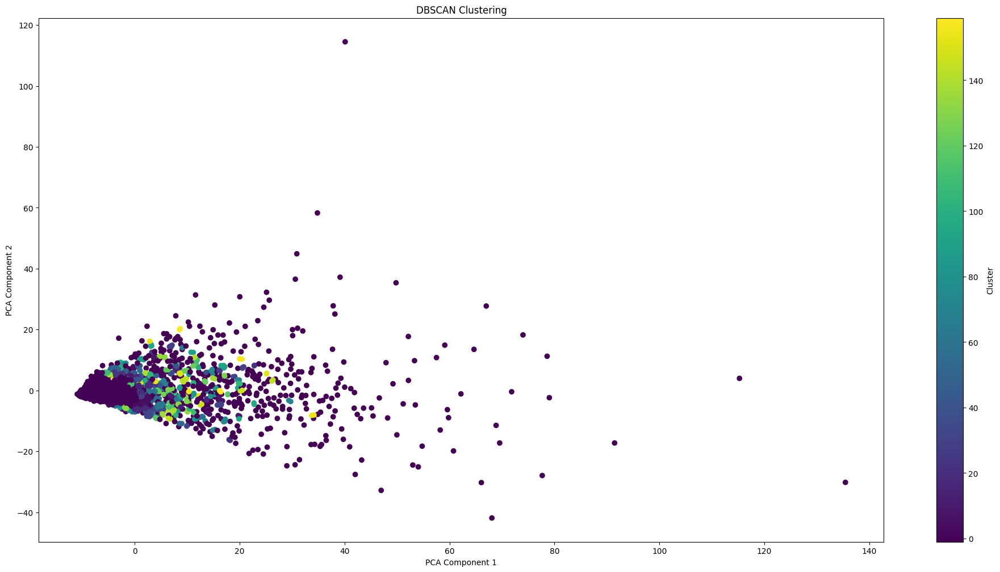

Cluster 0:
	['Он считает, что в деле нет никакого криминала Источник: Министерство здравоохранения Красноярского края   krasnoyarsk.dk.ru, Артем Ленц   NGS24.RU Защитник бывшей замминистра Минздрава Красноярского края Анны Москвиной Эдуард Клейман поделился мнением о ее задержании. Бывшую чиновницу обвиняют в превышении должностных полномочий при поставке медоборудования. Следствие полагает, что Москвина закупила некачественную технику. Женщину отправили под домашний арест. Адвокат рассказал NGS24.RU, что дело ведется уже полтора-два года, и, несмотря на то, что Москвиной выдвинули меру пресечения, он не считает, что положение дел подзащитной ухудшается. Дело было возбуждено по другим фигурантам, ну вот решили возбудить в отношении нее. Будем разбираться. Дело давно уже идет, какой-то истерики нет ни у следствия, ни у нас. Будем разбираться. Эдуард Клейман полагает, что в деле с закупками замешаны «другие сотрудники Минздрава края». Также адвокат полагает, что даже если было допущено н

In [52]:
# Визуализация результатов
df = pd.DataFrame({'x': X_pca[:, 0], 'y': X_pca[:, 1], 'cluster': clusters})

plt.figure(figsize=(24, 12))
plt.scatter(df['x'], df['y'], c=df['cluster'], cmap='viridis', marker='o')
plt.title('DBSCAN Clustering')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.colorbar(label='Cluster')
plt.show()

if os.path.isfile('output_cluster.txt'):
    os.remove('output_cluster.txt')

# Выделение тем по кластерам
for cluster in set(clusters):
    cluster_texts = [texts_cluster[i] for i in range(len(clusters)) if clusters[i] == cluster]
    # вывод в файл, для удобного чтения
    with open('output_cluster.txt', 'a+') as file:
        file.writelines(f'Cluster {cluster}:\n\t{cluster_texts}\n\n')

    print(f"Cluster {cluster}:\n\t{cluster_texts}")

### Анализ

На выходе вышло 159 кластеров со своими тематиками и один кластер, где не удалось отнести ни к одному кластери различные статьи.

Кластер 0: Тематика связанная с криминальными сводками города, асоцильным поведением, а так же другими противоправными делать граждан, как города Красноярск, так и общемировыми.

Кластер 1: Здесь общая тематика связанная с творчеством людей и шоу-бизнесом и отдыхом

Кластер 2: Тематика заботы и себе и своих близких, какие-то волнения и т.д.

Кластер -1: Здесь имеются темы, которые можно было бы отнести к одному из кластеров, однако DBSCAN посчитал иное.